![image.png](attachment:c764f245-0f4a-4f99-927a-350ad3981955.png)

**AFO - Aerial dataset of floating objects**

Aerial dataset for maritime Search and Rescue applications.

AFO dataset is the first free dataset for training machine learning and deep learning models for maritime Search and Rescue applications. It contains aerial-drone videos with 40,000 hand-annotated persons and objects floating in the water, many of small size, which makes them difficult to detect.

The AFO dataset contains images taken from fifty video clips containing objects floating on the water surface, captured by the various drone-mounted cameras (from 1280x720 to 3840x2160 resolutions), which have been used to create AFO. From these videos, we have extracted and manually annotated 3647 images that contain 39991 objects.These have been then split into three parts: the training (67,4% of objects), the test (19,12% of objects), and the validation set (13,48% of objects). In order to prevent overfitting of the model to the given data, the test set contains selected frames from nine videos that were not used in either the training or validation sets.


**Citation, BibteX:**

@article{article,

author = {Gąsienica-Józkowy, Jan and Knapik, Mateusz and Cyganek, Boguslaw},

year = {2021},

month = {01},

pages = {1-15},

title = {An ensemble deep learning method with optimized weights for drone-based water rescue and surveillance},

journal = {Integrated Computer-Aided Engineering},

doi = {10.3233/ICA-210649}

}

**Acknowledgements**

This work was supported by the Polish National Science Center under grant no. 2016/21/B/ST6/01461. We would also like to express our thanks to Agnieszka Malonik Taggart, Wojciech Sulewski, Dariusz Nawrocki, and Wojciech Kubiela - photographs who decided to support our project by sending us videos for the AFO dataset.

**License:**

The datasets provided on this page are published under the Creative Commons Attribution-NonCommercial-ShareAlike 3.0 License.

In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

**Importing Modules**

In [ ]:
import numpy as np
import cv2
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import os
import glob
import shutil
from pathlib import Path
import torch

**Data Paths**

In [ ]:
#Set up our img paths
part_1 = '/kaggle/input/afo-aerial-dataset-of-floating-objects/PART_1/PART_1/images'
part_2 = '/kaggle/input/afo-aerial-dataset-of-floating-objects/PART_2/PART_2/images'
part_3 = '/kaggle/input/afo-aerial-dataset-of-floating-objects/PART_3/PART_3/images'
# Annotation paths
annotation_path = '/kaggle/input/afo-aerial-dataset-of-floating-objects/PART_1/PART_1/6categories'

In [ ]:
root_img_path = Path('/kaggle/working/Dataset/images')
root_ann_path = Path('/kaggle/working/Dataset/annotations')

if not root_img_path.exists():
        print(f"Path {root_img_path} does not exit")
        os.makedirs(root_img_path)

if not root_ann_path.exists():
        print(f"Path {root_ann_path} does not exit")
        os.makedirs(root_ann_path)

Path /kaggle/working/Dataset/images does not exit
Path /kaggle/working/Dataset/annotations does not exit


In [ ]:
# Copy files from our img paths to our image folder in our working directory
def copy_files(src, dest):
    files = os.listdir(src)
    for file in files:
        shutil.copy2(os.path.join(src,file), dest)

copy_files(part_1, root_img_path)
copy_files(part_2, root_img_path)
copy_files(part_3, root_img_path)
copy_files(annotation_path, root_ann_path)

**EDA & Visualizations**

3641
(2720, 1530)


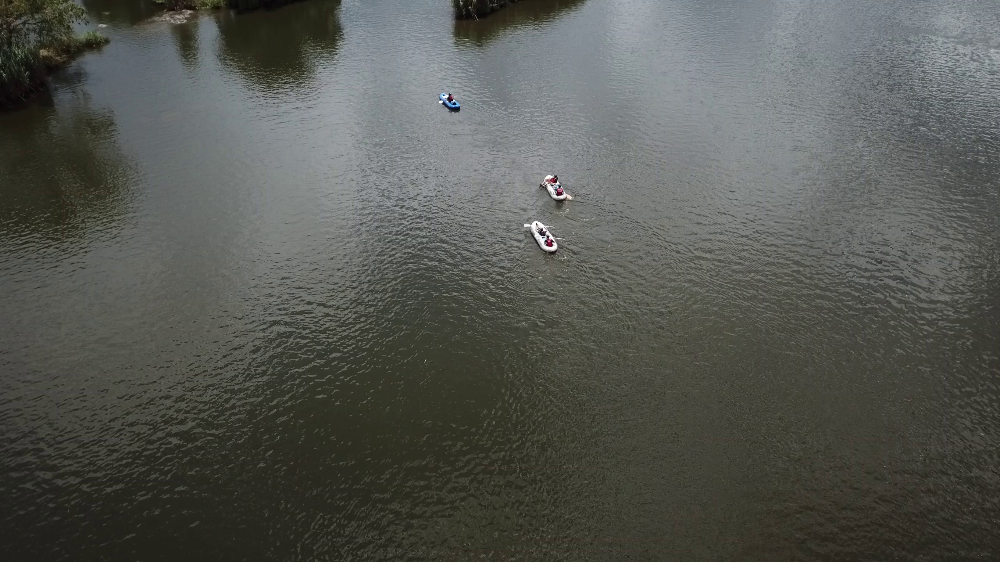

In [ ]:
images_path = '/kaggle/working/Dataset/images'
images_list = glob.glob(os.path.join(images_path , "*.jpg"))
print(len(images_list))
#visualise a single image
# img = cv2.imread(images_list[0])
# plt.imshow(img)
# plt.show()
img = Image.open(images_list[0])
print(img.size)
img

In [ ]:
#Visualise a single annotation
annot_path = '/kaggle/working/Dataset/annotations'
annot_list = glob.glob(os.path.join(annot_path , "*.txt"))
# annot_list[0]
with open(annot_list[0], 'r') as f:
    file = f.read()
    print(file)

In [ ]:
# A function to load a select a set amount of images
import random
def loadImages(imgList, num):
    loadedImages = []
    #iterate a defined number of times
    for i in range(num):
        #select a random index within the img list length
        ind = random.randint(1,len(imgList))
        img = cv2.imread(imgList[ind])
        loadedImages.append(img)
    return loadedImages

plot_img_data = loadImages(images_list, 15)
# plot_img_data[:2]

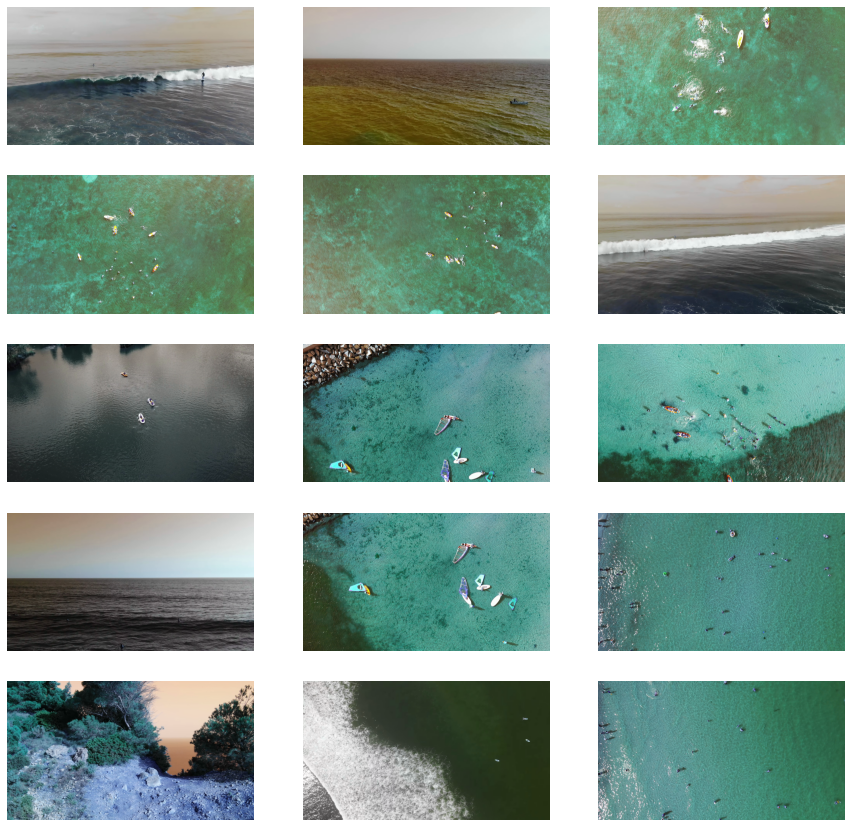

In [ ]:
plt.figure(figsize=(15,15))
for i in range(15):
    plt.subplot(5,3,i+1)
    plt.imshow(plot_img_data[i])
    plt.axis('off')

In [ ]:
import random
# Fuction to get images and their corresponding annotations
def loadImgAnn(img_path, ann_path, num):
    # return array of images
    imgList = os.listdir(img_path)
    annList = os.listdir(ann_path)
    #create lists to hold our values
    loadedImages = []
    loadedAnn = []
    #iterate a defined number of times
    for i in range(num):
        #select a random index within the our list length
        ind = random.randint(1,len(imgList))
        img = Image.open(img_path + '/' + imgList[ind])
        #As both images and annotations are named exactly, we get the annotations for each img
        file = os.path.basename(img_path + '/' + imgList[ind])
#         print(file)
        file_name = file[:-3] + 'txt' #replacing the extensions to txt from jpg on our filename
        with open((ann_path + '/' + file_name), 'r') as f:
            temp = [line for line in f.readlines()]
            loadedAnn.append(temp)
        loadedImages.append(img)
    return loadedImages, loadedAnn

In [ ]:
loadedImgs, loadedAnnots = loadImgAnn(images_path, annot_path, 3)
print(len(loadedAnnots))
loadedAnnots[0]

3


[]

In [ ]:
# Function to transform the values in our annotations to a float datatype
def floatannot(AnnList):
    coords = []
    float_coords = []
    #Go through our annotation list and scrape all our values into individul lists
    for i in AnnList:
        temp = []
        for ii in i:
            temp.append(ii.split())
        #Append list values to coord list
        coords.append(temp)
    #open coord list
    for i in coords:
        fltemp = []
        for ii in i:
            #Check if val is empty
            if len(ii) >0:
                #convert to float value
                z = [float(iii) for iii in ii]
                fltemp.append(z)
        float_coords.append(fltemp)
    return float_coords

In [ ]:
annot_coords = floatannot(loadedAnnots)
annot_coords[0]

[]

In [ ]:
# Get image coordinates to be plotted on our images
#convert yolo annotations to image coordinates for bounding boxes
def img_coords(coords, img):
    img_size = img.size
    img_width = img_size[0]
    img_height = img_size[1]

    x1 = float(img_width) * (2.0 * float(coords[1]) - float(coords[3])) / 2.0
    y1 = float(img_height) * (2.0 * float(coords[2]) - float(coords[4])) / 2.0
    x2 = float(img_width) * (2.0 * float(coords[1]) + float(coords[3])) / 2.0
    y2 = float(img_height) * (2.0 * float(coords[2]) + float(coords[4])) / 2.0

    return [int(x1), int(y1), int(x2), int(y2)]

In [ ]:
coords_list = []
for i in range(3):
    temp = []
    img = loadedImgs[i]
    for ii in annot_coords[i]:
        z = img_coords(ii, img)
        temp.append(z)
    coords_list.append(temp)
coords_list[0]

[]

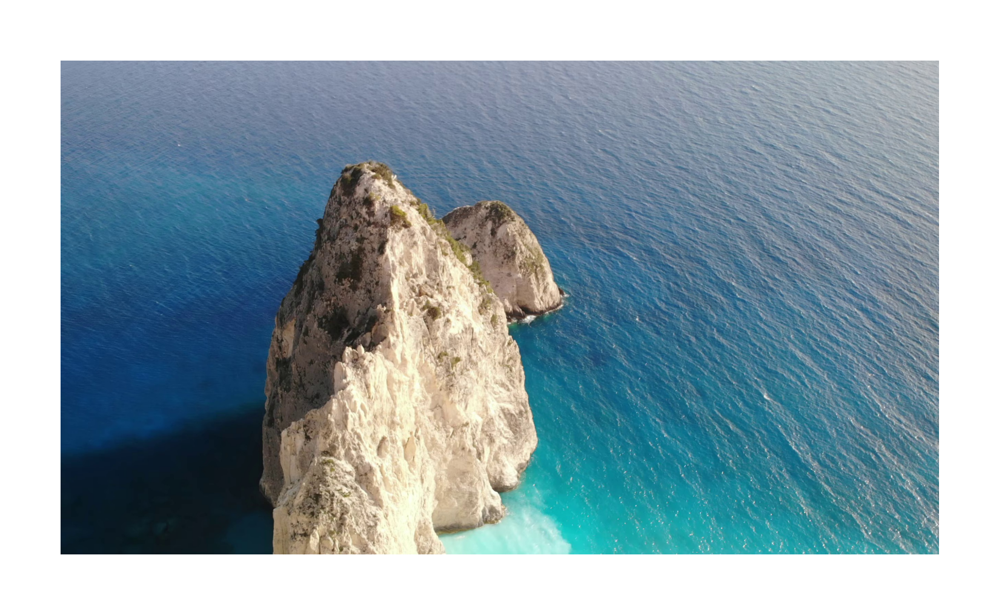

In [ ]:
def draw_annot(img, annotList):
#     npimg = np.array(img)
#     cvImage = cv2.cvtColor(npimg, cv2.COLOR_RGB2BGR)
    img_copy = img.copy()
    for annot in annotList:
        drawImg = ImageDraw.Draw(img_copy)
        drawImg.rectangle(annot, outline=(255, 0, 0), width=2)
#         cv2.rectangle(cvImage, (annot[0], annot[1]), (annot[2], annot[3]), (255,0,0), 2)
    plt.imshow(img_copy)
    plt.axis('off')

# plt.figure(figsize=(15,15))
plt.figure(figsize=(1.920,1.080), dpi=1000)
draw_annot(loadedImgs[0], coords_list[0])

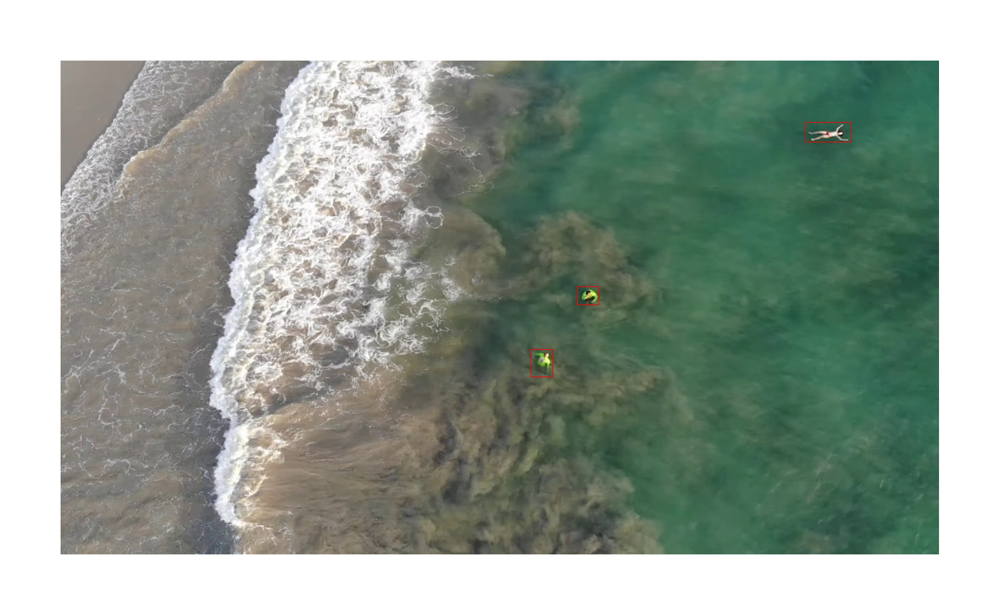

In [ ]:
plt.figure(figsize=(1.920,1.080), dpi=1000)
draw_annot(loadedImgs[1], coords_list[1])

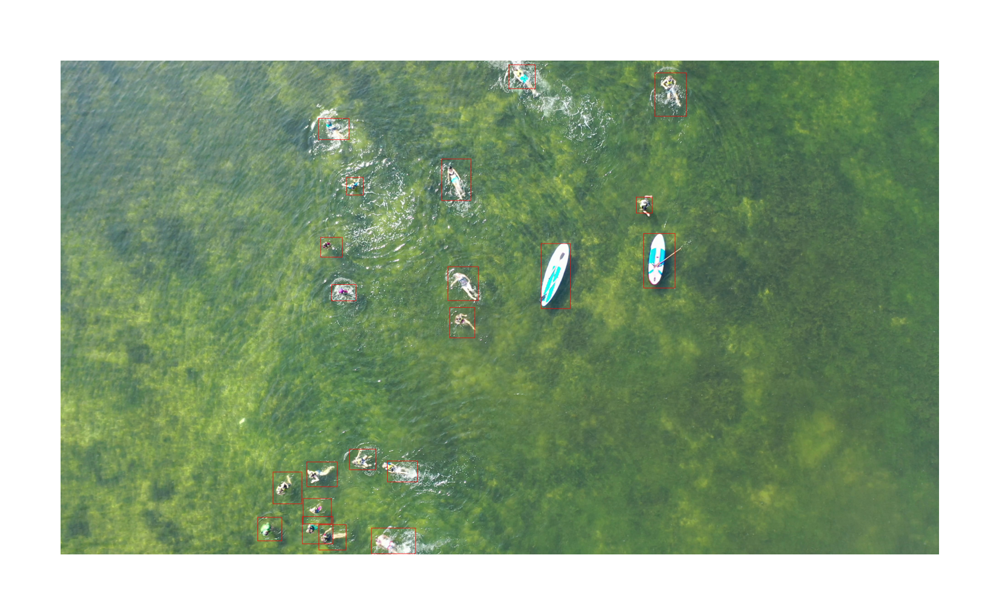

In [ ]:
plt.figure(figsize=(1.920,1.080), dpi=1000)
draw_annot(loadedImgs[2], coords_list[2])

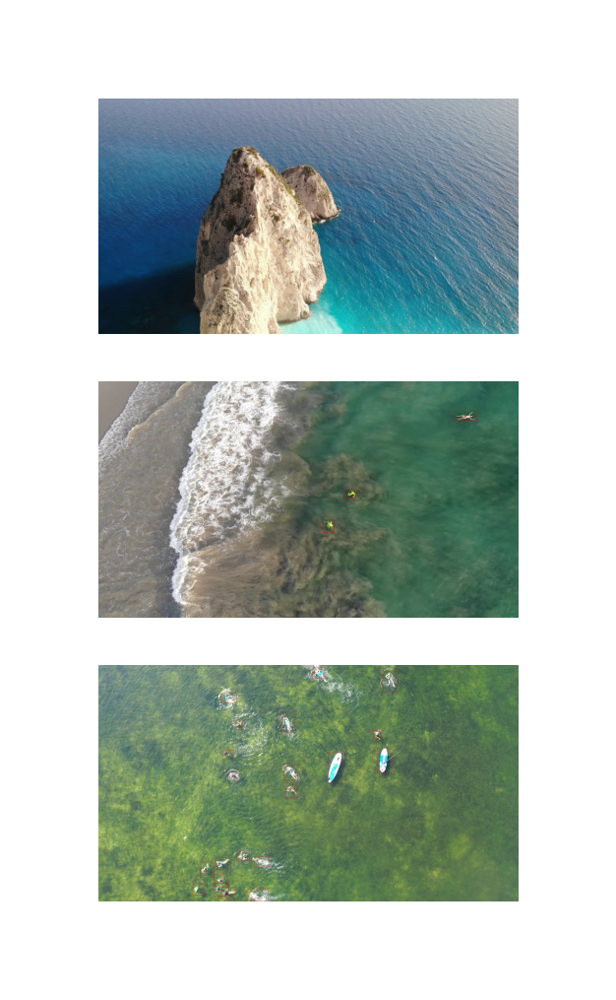

In [ ]:
plt.figure(figsize=(1.920,1.080), dpi=1000)
for i in range(3):
    plt.subplot(3,1,i+1)
    draw_annot(loadedImgs[i], coords_list[i])

**Split Data into Train, Test & Validation**

In [ ]:
# Recall:
# These have been then split into three parts: the training (67,4% of objects), the test (19,12% of objects),
# and the validation set (13,48% of objects). In order to prevent overfitting of the model to the given data,
# the test set contains selected frames from nine videos that were not used in either the training or validation sets.

def split_data(file_list, img_path, ann_path, mode):
    #Check if we have our mode folders
    root_file = Path( '/kaggle/working/Dataset/images/'+  mode)
    if not root_file.exists():
        print(f"Path {root_file} does not exit")
        os.makedirs(root_file)

    root_file = Path('/kaggle/working/Dataset/labels/' + mode)
    if not root_file.exists():
        print(f"Path {root_file} does not exit")
        os.makedirs(root_file)

    #Creates the name of our label file from the img name and creates our source file
    for file in file_list:
        name = file.replace('.jpg', '')
        img_src_file = img_path + '/' + name + '.jpg'
        annot_src_file = ann_path + '/' + name + '.txt'

        #move image
        IMG_DIR = '/kaggle/working/Dataset/images/' + mode
        img_dest_file = IMG_DIR + '/' + name + '.jpg'
        if os.path.isfile(img_src_file):
            shutil.move(img_src_file, img_dest_file)

        # Copy annotations
        ANNOT_DIR = '/kaggle/working/Dataset/labels/' + mode
        annot_dest_file = ANNOT_DIR + '/' + name + '.txt'
        if os.path.isfile(annot_src_file):
            shutil.move(annot_src_file, annot_dest_file)

In [ ]:
#Get our images list
train_imgs = '/kaggle/input/afo-aerial-dataset-of-floating-objects/PART_1/PART_1/train.txt'
test_imgs = '/kaggle/input/afo-aerial-dataset-of-floating-objects/PART_1/PART_1/test.txt'
val_imgs = '/kaggle/input/afo-aerial-dataset-of-floating-objects/PART_1/PART_1/validation.txt'
with open(train_imgs, 'r') as f:
    train_img_list = [line.strip() for line in f.readlines()]

with open(test_imgs, 'r') as f:
    test_img_list = [line.strip() for line in f.readlines()]

with open(val_imgs, 'r') as f:
    val_img_list = [line.strip() for line in f.readlines()]

print(train_img_list[0], test_img_list[0], val_img_list[0])

a_102.jpg k2_38.jpg a_101.jpg


In [ ]:
#Split Data
split_data(train_img_list, images_path, annot_path, 'train')
split_data(test_img_list, images_path, annot_path, 'test')
split_data(val_img_list, images_path, annot_path, 'val')

Path /kaggle/working/Dataset/images/train does not exit
Path /kaggle/working/Dataset/labels/train does not exit
Path /kaggle/working/Dataset/images/test does not exit
Path /kaggle/working/Dataset/labels/test does not exit
Path /kaggle/working/Dataset/images/val does not exit
Path /kaggle/working/Dataset/labels/val does not exit


In [ ]:
!ls /kaggle/working/Dataset
!ls /kaggle/working/Dataset/images
!ls /kaggle/working/Dataset/labels

annotations  images  labels
i3_200.jpg  test  train  val
test  train  val


**Model Training and Preparation**

For our model building, we will be using the ultralytics YoloV5 medium model. We will also be freezing some layers in our model to futher fine tune our model building process.

In [ ]:
# Download our Yolov5 model
!git clone https://github.com/ultralytics/yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 14845, done.
remote: Counting objects: 100% (190/190), done.
remote: Compressing objects: 100% (77/77), done.
remote: Total 14845 (delta 130), reused 162 (delta 113), pack-reused 14655
Receiving objects: 100% (14845/14845), 13.88 MiB | 23.00 MiB/s, done.
Resolving deltas: 100% (10213/10213), done.


In [ ]:
%cd yolov5
!ls

/kaggle/working/yolov5
CITATION.cff	 README.zh-CN.md  detect.py   requirements.txt	tutorial.ipynb
CONTRIBUTING.md  benchmarks.py	  export.py   segment		utils
LICENSE		 classify	  hubconf.py  setup.cfg		val.py
README.md	 data		  models      train.py


In [ ]:
#Creating a Yaml file for our yolov5 model
import yaml

dict_file = {'train':'/kaggle/working/Dataset/images/train' ,
            'val': '/kaggle/working/Dataset/images/val',
            'nc' : '6',
            'names' : ['human', 'wind/sup-board', 'boat', 'bouy', 'sailboat', 'kayak']
            }

with open('/kaggle/working/yolov5/data/AFO.yaml', 'w+') as file:
    documents = yaml.dump(dict_file, file)

In [ ]:
!ls

CITATION.cff	 README.zh-CN.md  detect.py   requirements.txt	tutorial.ipynb
CONTRIBUTING.md  benchmarks.py	  export.py   segment		utils
LICENSE		 classify	  hubconf.py  setup.cfg		val.py
README.md	 data		  models      train.py


In [ ]:
!ls data

AFO.yaml	      Objects365.yaml  coco.yaml	 images
Argoverse.yaml	      SKU-110K.yaml    coco128-seg.yaml  scripts
GlobalWheat2020.yaml  VOC.yaml	       coco128.yaml	 xView.yaml
ImageNet.yaml	      VisDrone.yaml    hyps


In [ ]:
# Disable weight and biases
!wandb disabled

W&B disabled.


In [ ]:
# YOLOv5 Model training with Layer Freezing
!python train.py --data data/AFO.yaml --weights yolov5m.pt --img 1280 --epochs 25 --batch-size 32 --freeze 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

train: weights=yolov5m.pt, cfg=, data=data/AFO.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=30, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
requirements: YOLOv5 requirement "thop>=0.1.1" not found, attempting AutoUpdate...

requirements: 1 package updated per /kaggle/working/yolov5/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect

YOLOv5 🚀 v7.0-46-g96a71b1 Python-3.7.12 torch-1.11.0 CUDA:0 (T

In [ ]:
!ls
print('')
!ls runs/train/exp

CITATION.cff	 __pycache__	export.py	  segment	  val.py
CONTRIBUTING.md  benchmarks.py	hubconf.py	  setup.cfg	  wandb
LICENSE		 classify	models		  train.py	  yolov5m.pt
README.md	 data		requirements.txt  tutorial.ipynb
README.zh-CN.md  detect.py	runs		  utils

F1_curve.png					   results.png
PR_curve.png					   train_batch0.jpg
P_curve.png					   train_batch1.jpg
R_curve.png					   train_batch2.jpg
confusion_matrix.png				   val_batch0_labels.jpg
events.out.tfevents.1671636176.303de9fb6d88.158.0  val_batch0_pred.jpg
hyp.yaml					   val_batch1_labels.jpg
labels.jpg					   val_batch1_pred.jpg
labels_correlogram.jpg				   val_batch2_labels.jpg
opt.yaml					   val_batch2_pred.jpg
results.csv					   weights


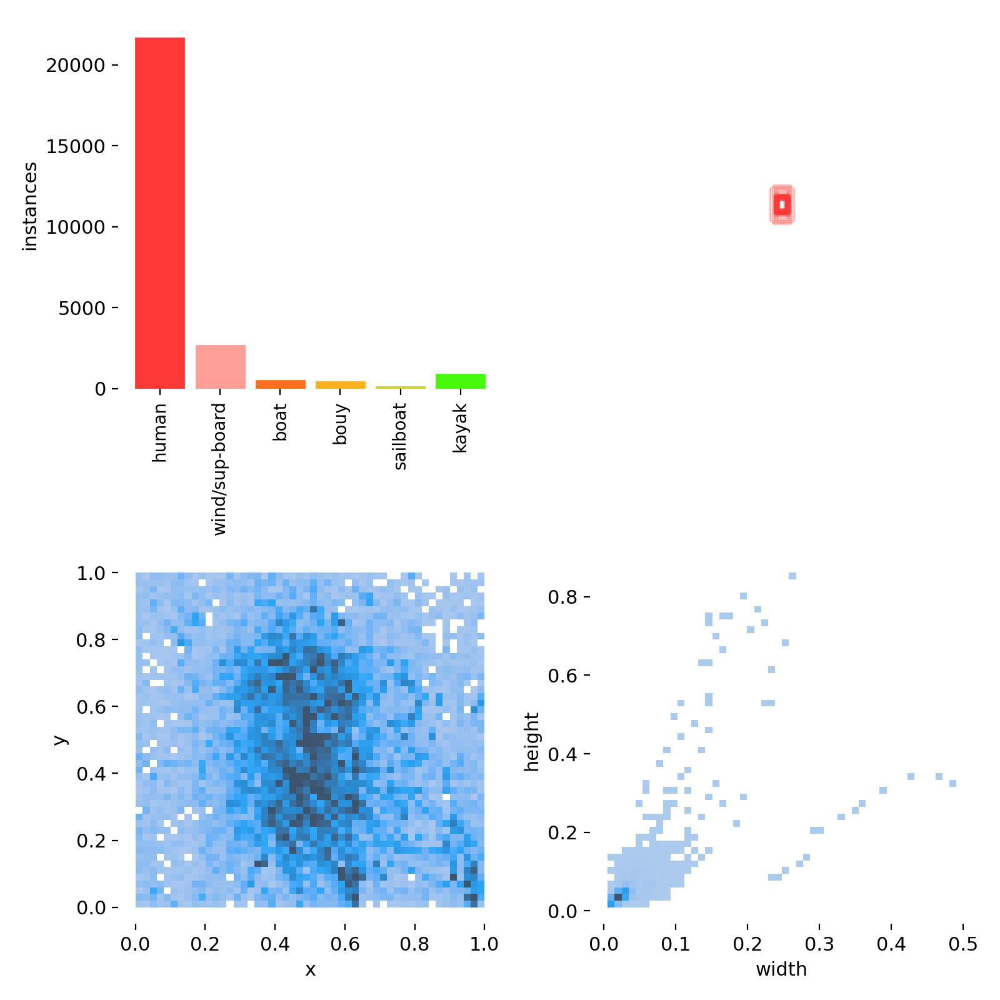

In [ ]:
Image.open('runs/train/exp/labels.jpg')

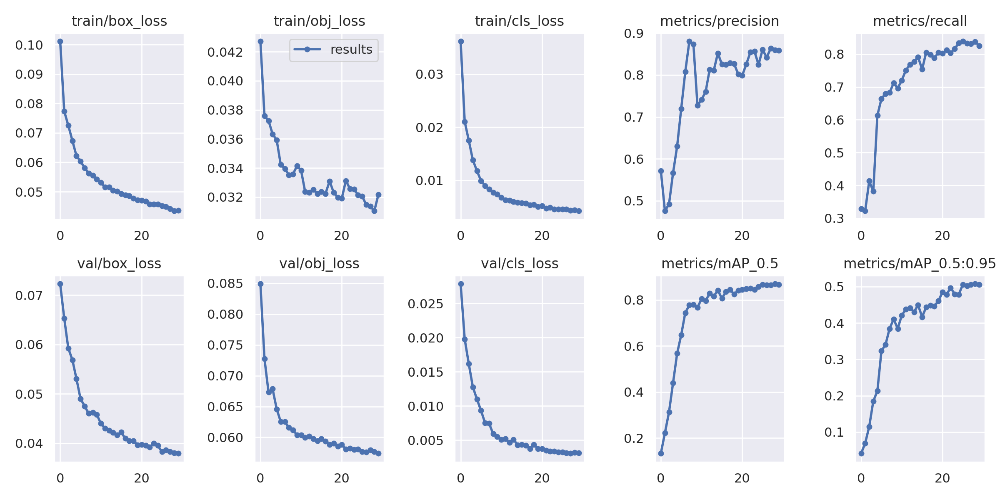

In [ ]:
Image.open('runs/train/exp/results.png')

In [ ]:
!python detect.py --img 640 --source /kaggle/working/Dataset/images/test --weights runs/train/exp/weights/best.pt --conf-thres 0.3

detect: weights=['runs/train/exp/weights/best.pt'], source=/kaggle/working/Dataset/images/test, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.3, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-46-g96a71b1 Python-3.7.12 torch-1.11.0 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model summary: 212 layers, 20873139 parameters, 0 gradients, 47.9 GFLOPs
image 1/514 /kaggle/working/Dataset/images/test/a_301.jpg: 384x640 30 humans, 5 wind/sup-boards, 12.1ms
image 2/514 /kaggle/working/Dataset/images/test/a_302.jpg: 384x640 33 humans, 5 wind/sup-boards, 9.4ms
image 3/514 /kaggle/working/Dataset/images/test/a_303.jpg: 384x640 32 humans, 4 wind/sup-boards, 9.3ms
image 4/514 /ka

In [ ]:
!ls runs

detect	train


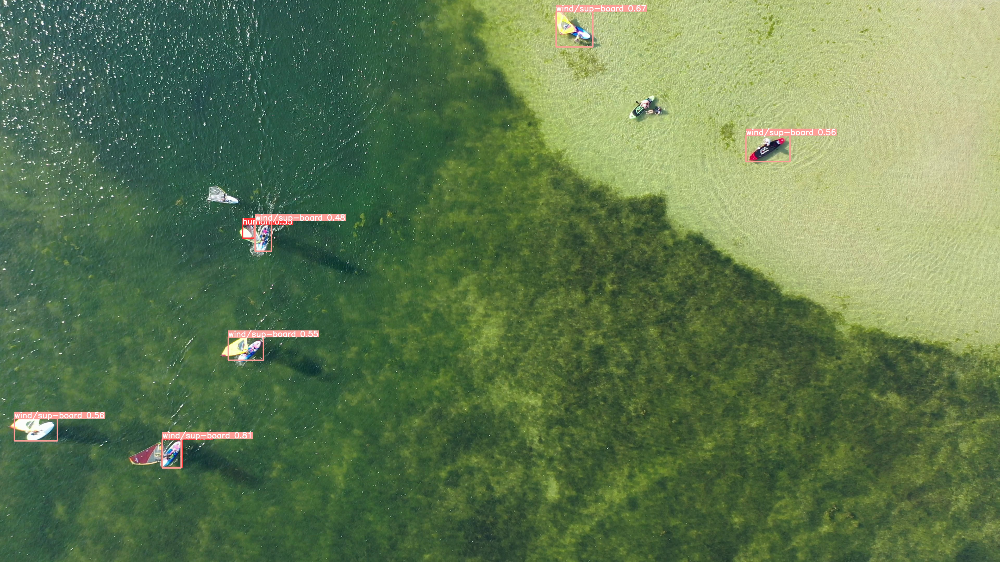

In [ ]:
Image.open('runs/detect/exp/wv_411.jpg')

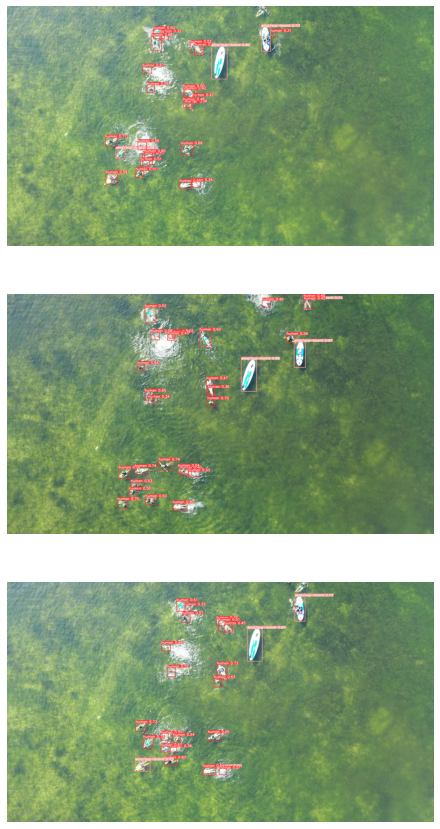

In [ ]:
def loadPILImages(path, num):
    # return array of images
    imgList = os.listdir(path)
    loadedImages = []
    #iterate a defined number of times
    for i in range(num):
        #select a random index within the img list length
        ind = random.randint(1,len(imgList))
        img = Image.open(path + imgList[ind])
        loadedImages.append(img)
    return loadedImages

test_data_path = 'runs/detect/exp/'
# test_img_list = glob.glob(os.path.join(test_data_path , "*.jpg"))
test_data_img = loadPILImages(test_data_path, 3)

plt.figure(figsize=(15,15))
for i in range(3):
    plt.subplot(3,1,i+1)
    plt.imshow(test_data_img[i])
    plt.axis('off')

In [ ]:
%cd /kaggle/working/

/kaggle/working


In [ ]:
!zip -r file.zip /kaggle/working/yolov5

  adding: kaggle/working/yolov5/ (stored 0%)
  adding: kaggle/working/yolov5/detect.py (deflated 69%)
  adding: kaggle/working/yolov5/README.md (deflated 79%)
  adding: kaggle/working/yolov5/train.py (deflated 69%)
  adding: kaggle/working/yolov5/CITATION.cff (deflated 31%)
  adding: kaggle/working/yolov5/.gitattributes (deflated 4%)
  adding: kaggle/working/yolov5/hubconf.py (deflated 73%)
  adding: kaggle/working/yolov5/.github/ (stored 0%)
  adding: kaggle/working/yolov5/.github/workflows/ (stored 0%)
  adding: kaggle/working/yolov5/.github/workflows/codeql-analysis.yml (deflated 52%)
  adding: kaggle/working/yolov5/.github/workflows/greetings.yml (deflated 61%)
  adding: kaggle/working/yolov5/.github/workflows/translate-readme.yml (deflated 47%)
  adding: kaggle/working/yolov5/.github/workflows/stale.yml (deflated 59%)
  adding: kaggle/working/yolov5/.github/workflows/ci-testing.yml (deflated 73%)
  adding: kaggle/working/yolov5/.github/workflows/docker.yml (deflated 67%)
  adding: